### Rankingowanie ofert turystycznych w Solr

**Importowanie bibliotek**

In [1]:
import json
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import requests
import seaborn as sns
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import xgboost as xgb
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

**Przygotowanie danych z kliknięć:**
Wczytaj dane, z których będziesz uczyć model. Dane zawierają informacje na temat wyszukiwań użytkowników.

In [3]:
dane_klikniecia = pd.read_csv('dane_klikniecia.csv')
dane_klikniecia.dropna(subset=['id'], inplace=True)
dane_klikniecia

,query_id,query,user,list_event_timestamp,ga_session_id,search_page,id,hotel,kraj,miasto,region,price,item_list_index,click_event_timestamp,cart_event_timestamp,click,cart,search_adults,search_departureDateMax,search_departureDateMin,search_transportType,search_maintenance,search_hotelCategoryMax,search_hotelCategoryMin,search_periodMax,search_periodMin,search_children,search_childrenBirthDates,search_departure_city,search_priceMax,search_priceMin,search_country,search_region,search_city,search_offerType
0,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,5836,Iberostar Tainos,Kuba,Varadero,Varadero,5417.0,7,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
1,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,6372,Sol Palmeras,Kuba,Varadero,Varadero,5352.0,6,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
2,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,5838,Melia Las Antillas,Kuba,Varadero,Varadero,5288.0,2,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
3,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,6696,Roc Arenas Dorades,Kuba,Varadero,Varadero,5320.0,5,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
4,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,5835,Iberostar Playa Alameda,Kuba,Varadero,Varadero,5288.0,1,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
5,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,6692,Iberostar Bella Vista Varadero,Kuba,Varadero,Varadero,5610.0,9,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
6,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,5840,Melia Peninsula Varadero,Kuba,Varadero,Varadero,5320.0,4,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
7,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,6367,Grand Memories Varadero,Kuba,Varadero,Varadero,5223.0,0,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
8,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,6697,Sol Varadero Beach,Kuba,Varadero,Varadero,5288.0,3,NaN,NaN,0,0,NaN,NaN,NaN,samolot,All Inclusive,NaN,NaN,0,0,NaN,NaN,Warszawa - Okecie,0,0,Kuba,Varadero,Varadero,NaN
9,b4b5ff15-ffa8-41f6-9c26-e567ffaa044f,country=Kuba&departureCity=Warszawa - Okecie&t...,_101199264.1686554760_,1687943908917777,1687943760,https: www.primaholiday.pl szukaj?country=Kub...,6636,Melia Varadero,Kuba,Varadero,Varader

**Zbadanie danych**

In [4]:
# Wyświetlenie wyszukiwań

queries = list(set(dane_klikniecia['query'].to_list()))
for q in queries:
    print(q,'\n') 

country=Egipt&departureCity=Katowice&adults=2&departureDateMax=2023-09-21&departureDateMin=2023-09-11&transportType=samolot&periodMax=7&periodMin=7&maintenance=All Inclusive&region=Marsa Alam&priceMax=5539&priceMin=3849 

country=Tunezja&departureCity=Warszawa - Okecie&adults=1&departureDateMax=2023-07-02&departureDateMin=2023-06-22&transportType=samolot&maintenance=All Inclusive&region=Sousse El Kantaoui&city=Sousse 

country=Grecja&departureCity=Krakow&departureDateMax=2023-09-30&departureDateMin=2023-09-25&transportType=samolot&maintenance=All Inclusive&region=Kreta Wschodnia&city=Analipsi 

country=Hiszpania&departureCity=Wroclaw&transportType=samolot&periodMax=14&periodMin=8&maintenance=sniadania i obiadokolacje&region=Costa Brava&city=Santa Susanna&hotelCategoryMax=50&hotelCategoryMin 

country=Tunezja&departureCity=Katowice&adults=2&departureDateMax=2023-06-29&departureDateMin=2023-06-22&transportType=samolot&maintenance=All Inclusive&region=Mahdia 

country=Kuba&departureCity=K

In [5]:
# Wyświetlenie wyszukiwanych krajów i liczby wystąpień poszczególnych wartości

kolumna = 'search_country'
dane_klikniecia[kolumna].value_counts()

Egipt         1710
Grecja        1550
Tunezja       1460
Hiszpania      470
Bulgaria       370
Turcja         360
Chorwacja      320
Kuba           300
Sri Lanka      170
Albania        150
Cypr            80
Tanzania        60
Dominikana      60
Malediwy        30
Malta           30
Czarnogora      20
Maroko          10
Indonezja       10
Tajlandia       10
Name: search_country, dtype: int64

In [6]:
# Wyświetlenie ilości zdarzenia kliknięć

kolumna = 'click'
dane_klikniecia[kolumna].value_counts()

0    7032
1     138
Name: click, dtype: int64

In [7]:
# Wyświetlenie wyszukiwanych krajów i liczby wystąpień poszczególnych wartości
# według wartości binarnej kliknięć

dane_klikniecia.groupby(['click', 'search_country']).size().reset_index(name='counts')

,click,search_country,counts
0,0,Albania,149
1,0,Bulgaria,369
2,0,Chorwacja,319
3,0,Cypr,77
4,0,Czarnogora,20
5,0,Dominikana,60
6,0,Egipt,1664
7,0,Grecja,1537
8,0,Hiszpania,439
9,0,Indonezja,9


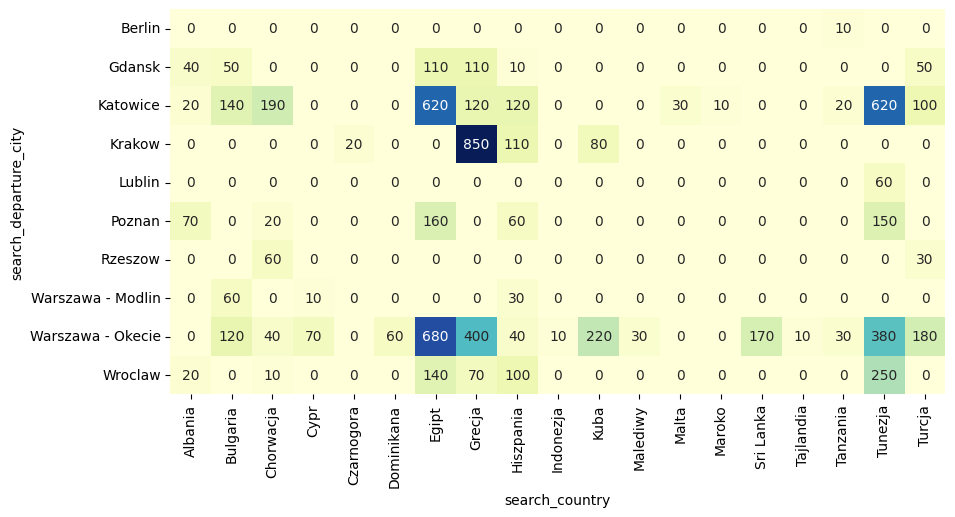

In [8]:
# Mapa cieplna, która prezentuje wzajemne relacje między 'search_departure_city' i 'search_country', 
# ilustrując liczbę wystąpień poszczególnych kombinacji wartości.

plt.figure(figsize = (10,5))

ax =sns.heatmap(pd.crosstab(
    dane_klikniecia.search_departure_city, dane_klikniecia.search_country),
    cmap="YlGnBu", annot=True , cbar=False, fmt='.0f')

**Ekstraktory cech:** Przygotuj cechy popularności krajów docelowych i miast wylotolu.

In [9]:
def calculate_popularity_score(data, click_data, column):  
    list_column_data = pd.DataFrame(data.groupby(column).count()).reset_index()[[column, "query_id"]]
    list_column_data = list_column_data.rename(columns={'query_id': f'{column}_list_count'})
    
    click_column_data = pd.DataFrame(click_data.groupby(column).count()).reset_index()[[column, "query_id"]]
    click_column_data = click_column_data.rename(columns={'query_id': f'{column}_click_count'})
    
    merged_data = list_column_data.merge(click_column_data, on=column, how='left')
    merged_data = merged_data.fillna(0)
    
    merged_data[f"{column}_popularity_score"] = (merged_data[f"{column}_click_count"]/merged_data[f"{column}_list_count"])+1
    #merged_data = merged_data.sort_values(by=f"{column}_popularity_score", ascending=False)
    
    return merged_data

In [10]:
# Cecha popularności wyszukiwanego kraju.

click_data = dane_klikniecia[dane_klikniecia['click']==1]

search_country_popularity = calculate_popularity_score(dane_klikniecia,click_data,'search_country')
search_country_popularity = search_country_popularity[
    ['search_country','search_country_popularity_score']]
search_country_popularity.sort_values(by="search_country_popularity_score", ascending=False)

,search_country,search_country_popularity_score
9,Indonezja,1.100000
8,Hiszpania,1.065957
3,Cypr,1.037500
6,Egipt,1.026901
17,Tunezja,1.018493
14,Sri Lanka,1.017647
16,Tanzania,1.016667
10,Kuba,1.016667
18,Turcja,1.013889
7,Grecja,1.008387


In [11]:
# Cecha popularności wyszukiwanego miasta wylotu w przypadku transportu samolotem, dla ofert klikanych.

search_departure_city_popularity = calculate_popularity_score(dane_klikniecia,click_data,'search_departure_city')
search_departure_city_popularity = search_departure_city_popularity[
    ['search_departure_city','search_departure_city_popularity_score']]
search_departure_city_popularity.sort_values(by="search_departure_city_popularity_score", ascending=False)

,search_departure_city,search_departure_city_popularity_score
7,Warszawa - Modlin,1.040000
5,Poznan,1.028261
3,Krakow,1.025472
2,Katowice,1.021106
8,Warszawa - Okecie,1.016803
4,Lublin,1.016667
1,Gdansk,1.013514
9,Wroclaw,1.008475
0,Berlin,1.000000
6,Rzeszow,1.000000


In [12]:
# Dostosowanie wartości do danych zaindeksowanych w Solr

search_departure_city_popularity = search_departure_city_popularity.replace(
    {'Poznan':'Poznań', 
     'Krakow':'Kraków', 
     'Gdansk':'Gdańsk', 
     'Warszawa - Okecie': 'Warszawa - Okęcie', 
     'Wroclaw': 'Wrocław',
     'Rzeszow': 'Rzeszów'}, regex=True)


In [13]:
search_departure_city_popularity

,search_departure_city,search_departure_city_popularity_score
0,Berlin,1.000000
1,Gdańsk,1.013514
2,Katowice,1.021106
3,Kraków,1.025472
4,Lublin,1.016667
5,Poznań,1.028261
6,Rzeszów,1.000000
7,Warszawa - Modlin,1.040000
8,Warszawa - Okęcie,1.016803
9,Wrocław,1.008475


**Przygotowanie danych do indeksacji w Solr**

In [16]:
df_solr_test = pd.read_csv('dane_solr.csv')
df_solr_test

,unique_key,id,name_pl,type_pl,description_pl,property_category,term_departure_date,term_id,country_source_name_pl,term_departure_city_pl,term_maintenance_name_pl,region_source_name_pl,term_period,term_base_price,term_persons,term_total_price
0,58369d92761b62f3f5c957d0aab67c87f93e,5836,Iberostar Tainos,Wypoczynek,"Hotel położony w bujnym, tropikalnym ogrodzie,...",40,2023-08-31T00:00:00Z,9d92761b62f3f5c957d0aab67c87f93e,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,8,8701.0,2,17402.0
1,63728ed50e940d97dbebef0ca7734c7e7e2c,6372,Sol Palmeras,Wypoczynek,Hotel położony w Varadero około 5 km od centr...,40,2023-09-10T00:00:00Z,8ed50e940d97dbebef0ca7734c7e7e2c,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,7,13875.0,2,27750.0
2,5838d22db7f7442951fd35e8e7098cd11b81,5838,Melia Las Antillas,Wypoczynek,"Ok. 15 km od centrum Varadero, ok. 150 km od H...",50,2023-09-22T00:00:00Z,d22db7f7442951fd35e8e7098cd11b81,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,9,9487.0,2,18974.0
3,6696a07d47a492b076e7af6d19239868adb1,6696,Roc Arenas Dorades,Wypoczynek,Hotel położony tuż przy plaży w miejscowości V...,40,2023-08-29T00:00:00Z,a07d47a492b076e7af6d19239868adb1,Kuba,NaN,All Inclusive,Varadero,6,1599.0,2,3198.0
4,5835a32d2533dfb245147bd64cdcdac0f9ba,5835,Iberostar Playa Alameda,Wypoczynek,W odległości ok. 5 km od centrum handlowego Pl...,40,2023-09-26T00:00:00Z,a32d2533dfb245147bd64cdcdac0f9ba,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,11,7773.0,2,15546.0
5,6692103664b267512b3b46f8ab32bf63f3a2,6692,Iberostar Bella Vista Varadero,Wypoczynek,"Hotel położony w miejscowości Vardero, ok 5 km...",50,2023-10-04T00:00:00Z,103664b267512b3b46f8ab32bf63f3a2,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,13,8816.0,2,17632.0
6,5840fe9a4b8ef82bd49838271060838d31b8,5840,Melia Peninsula Varadero,Wypoczynek,"Ok. 18 km od centrum Varadero, przy hotelu Par...",50,2023-09-08T00:00:00Z,fe9a4b8ef82bd49838271060838d31b8,Kuba,NaN,All Inclusive,Varadero,12,4569.0,2,9138.0
7,6367988e5bbaaca3b29071bc05879378df86,6367,Grand Memories Varadero,Wypoczynek,"Hotel położony ok. 18 km od centrum VARADERO, ...",40,2023-10-07T00:00:00Z,988e5bbaaca3b29071bc05879378df86,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,11,6500.0,2,13000.0
8,669774599d1672794b41412d0502d93c22f7,6697,Sol Varadero Beach,Wypoczynek,"Hotel położony w miejscowości Varadero, ok. 2 ...",40,2023-08-14T00:00:00Z,74599d1672794b41412d0502d93c22f7,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,15,14002.0,2,28004.0
9,66360cef77eeac6fb9a70555afeb2921fa78,6636,Melia Varadero,Wypoczynek,"Położony w miejscowości Varadero, ok. 7 kmod c...",50,2023-09-23T00:00:00Z,0cef77eeac6fb9a70555afeb2921fa78,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,12,8804.0,2,17608.0


In [17]:
# Połączenie danych o ofertach z cechami wyodrębnionymi z kliknięć.
# Zmieniamy nazwy kolumn, aby wykonać operacje łączenia tabel.

search_country_popularity = search_country_popularity.rename(
    columns={"search_country":"country_source_name_pl"})
df_solr_test = pd.merge(
        df_solr_test, search_country_popularity,
        on="country_source_name_pl", how='left'
    )

search_departure_city_popularity = search_departure_city_popularity.rename(
    columns={"search_departure_city":"term_departure_city_pl"})
df_solr_test = pd.merge(
        df_solr_test, search_departure_city_popularity,
        on="term_departure_city_pl", how='left'
    )

df_solr_test

,unique_key,id,name_pl,type_pl,description_pl,property_category,term_departure_date,term_id,country_source_name_pl,term_departure_city_pl,term_maintenance_name_pl,region_source_name_pl,term_period,term_base_price,term_persons,term_total_price,search_country_popularity_score,search_departure_city_popularity_score
0,58369d92761b62f3f5c957d0aab67c87f93e,5836,Iberostar Tainos,Wypoczynek,"Hotel położony w bujnym, tropikalnym ogrodzie,...",40,2023-08-31T00:00:00Z,9d92761b62f3f5c957d0aab67c87f93e,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,8,8701.0,2,17402.0,1.016667,1.016803
1,63728ed50e940d97dbebef0ca7734c7e7e2c,6372,Sol Palmeras,Wypoczynek,Hotel położony w Varadero około 5 km od centr...,40,2023-09-10T00:00:00Z,8ed50e940d97dbebef0ca7734c7e7e2c,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,7,13875.0,2,27750.0,1.016667,1.016803
2,5838d22db7f7442951fd35e8e7098cd11b81,5838,Melia Las Antillas,Wypoczynek,"Ok. 15 km od centrum Varadero, ok. 150 km od H...",50,2023-09-22T00:00:00Z,d22db7f7442951fd35e8e7098cd11b81,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,9,9487.0,2,18974.0,1.016667,1.016803
3,6696a07d47a492b076e7af6d19239868adb1,6696,Roc Arenas Dorades,Wypoczynek,Hotel położony tuż przy plaży w miejscowości V...,40,2023-08-29T00:00:00Z,a07d47a492b076e7af6d19239868adb1,Kuba,NaN,All Inclusive,Varadero,6,1599.0,2,3198.0,1.016667,NaN
4,5835a32d2533dfb245147bd64cdcdac0f9ba,5835,Iberostar Playa Alameda,Wypoczynek,W odległości ok. 5 km od centrum handlowego Pl...,40,2023-09-26T00:00:00Z,a32d2533dfb245147bd64cdcdac0f9ba,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,11,7773.0,2,15546.0,1.016667,1.016803
5,6692103664b267512b3b46f8ab32bf63f3a2,6692,Iberostar Bella Vista Varadero,Wypoczynek,"Hotel położony w miejscowości Vardero, ok 5 km...",50,2023-10-04T00:00:00Z,103664b267512b3b46f8ab32bf63f3a2,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,13,8816.0,2,17632.0,1.016667,1.016803
6,5840fe9a4b8ef82bd49838271060838d31b8,5840,Melia Peninsula Varadero,Wypoczynek,"Ok. 18 km od centrum Varadero, przy hotelu Par...",50,2023-09-08T00:00:00Z,fe9a4b8ef82bd49838271060838d31b8,Kuba,NaN,All Inclusive,Varadero,12,4569.0,2,9138.0,1.016667,NaN
7,6367988e5bbaaca3b29071bc05879378df86,6367,Grand Memories Varadero,Wypoczynek,"Hotel położony ok. 18 km od centrum VARADERO, ...",40,2023-10-07T00:00:00Z,988e5bbaaca3b29071bc05879378df86,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,11,6500.0,2,13000.0,1.016667,1.016803
8,669774599d1672794b41412d0502d93c22f7,6697,Sol Varadero Beach,Wypoczynek,"Hotel położony w miejscowości Varadero, ok. 2 ...",40,2023-08-14T00:00:00Z,74599d1672794b41412d0502d93c22f7,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,15,14002.0,2,28004.0,1.016667,1.016803
9,66360cef77eeac6fb9a70555afeb2921fa78,6636,Melia Varadero,Wypoczynek,"Położony w miejscowości Varadero, ok. 7 kmod c...",50,2023-09-23T00:00:00Z,0cef77eeac6fb9a70555afeb2921fa78,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,12,8804.0,2,17608.0,1.016667,1.016803


In [18]:
# Wypełniamy brakujące wartości kolunm,
# aby umożliwić uwzględnienie brakujacych wartości podczas procesu trenowania.

fill_value = 0.000001

df_solr_test["search_departure_city_popularity_score"] = df_solr_test[
    "search_departure_city_popularity_score"
].fillna(fill_value)

df_solr_test["search_country_popularity_score"] = df_solr_test[
    "search_country_popularity_score"
].fillna(fill_value)

df_solr_test

,unique_key,id,name_pl,type_pl,description_pl,property_category,term_departure_date,term_id,country_source_name_pl,term_departure_city_pl,term_maintenance_name_pl,region_source_name_pl,term_period,term_base_price,term_persons,term_total_price,search_country_popularity_score,search_departure_city_popularity_score
0,58369d92761b62f3f5c957d0aab67c87f93e,5836,Iberostar Tainos,Wypoczynek,"Hotel położony w bujnym, tropikalnym ogrodzie,...",40,2023-08-31T00:00:00Z,9d92761b62f3f5c957d0aab67c87f93e,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,8,8701.0,2,17402.0,1.016667,1.016803
1,63728ed50e940d97dbebef0ca7734c7e7e2c,6372,Sol Palmeras,Wypoczynek,Hotel położony w Varadero około 5 km od centr...,40,2023-09-10T00:00:00Z,8ed50e940d97dbebef0ca7734c7e7e2c,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,7,13875.0,2,27750.0,1.016667,1.016803
2,5838d22db7f7442951fd35e8e7098cd11b81,5838,Melia Las Antillas,Wypoczynek,"Ok. 15 km od centrum Varadero, ok. 150 km od H...",50,2023-09-22T00:00:00Z,d22db7f7442951fd35e8e7098cd11b81,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,9,9487.0,2,18974.0,1.016667,1.016803
3,6696a07d47a492b076e7af6d19239868adb1,6696,Roc Arenas Dorades,Wypoczynek,Hotel położony tuż przy plaży w miejscowości V...,40,2023-08-29T00:00:00Z,a07d47a492b076e7af6d19239868adb1,Kuba,NaN,All Inclusive,Varadero,6,1599.0,2,3198.0,1.016667,0.000001
4,5835a32d2533dfb245147bd64cdcdac0f9ba,5835,Iberostar Playa Alameda,Wypoczynek,W odległości ok. 5 km od centrum handlowego Pl...,40,2023-09-26T00:00:00Z,a32d2533dfb245147bd64cdcdac0f9ba,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,11,7773.0,2,15546.0,1.016667,1.016803
5,6692103664b267512b3b46f8ab32bf63f3a2,6692,Iberostar Bella Vista Varadero,Wypoczynek,"Hotel położony w miejscowości Vardero, ok 5 km...",50,2023-10-04T00:00:00Z,103664b267512b3b46f8ab32bf63f3a2,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,13,8816.0,2,17632.0,1.016667,1.016803
6,5840fe9a4b8ef82bd49838271060838d31b8,5840,Melia Peninsula Varadero,Wypoczynek,"Ok. 18 km od centrum Varadero, przy hotelu Par...",50,2023-09-08T00:00:00Z,fe9a4b8ef82bd49838271060838d31b8,Kuba,NaN,All Inclusive,Varadero,12,4569.0,2,9138.0,1.016667,0.000001
7,6367988e5bbaaca3b29071bc05879378df86,6367,Grand Memories Varadero,Wypoczynek,"Hotel położony ok. 18 km od centrum VARADERO, ...",40,2023-10-07T00:00:00Z,988e5bbaaca3b29071bc05879378df86,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,11,6500.0,2,13000.0,1.016667,1.016803
8,669774599d1672794b41412d0502d93c22f7,6697,Sol Varadero Beach,Wypoczynek,"Hotel położony w miejscowości Varadero, ok. 2 ...",40,2023-08-14T00:00:00Z,74599d1672794b41412d0502d93c22f7,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,15,14002.0,2,28004.0,1.016667,1.016803
9,66360cef77eeac6fb9a70555afeb2921fa78,6636,Melia Varadero,Wypoczynek,"Położony w miejscowości Varadero, ok. 7 kmod c...",50,2023-09-23T00:00:00Z,0cef77eeac6fb9a70555afeb2921fa78,Kuba,Warszawa - Okęcie,All Inclusive,Varadero,12,8804.0,2,17608.0,1.016667,1.016803


**Indeksacja danych w Solr.**
Przed indeksacją utwórz kolekcję w Solr.

In [19]:
solr_url = 'http://hostname:port/solr'
headers = {'Content-type': 'application/json'}
collection_name = 'test_ltr_01'

In [20]:
# URL do aktualizacji danych w kolekcji Solr
update_url = f'{solr_url}/{collection_name}/update'

# Usuń istniejące dane z kolekcji Solr jeśli istnieją
delete_query = {'delete': {'query': '*:*'}}
delete_response = requests.post(update_url, json=delete_query, headers=headers)

# Zatwierdź zmiany
commit_url = f'{solr_url}/{collection_name}/update?commit=true'
requests.post(commit_url)

# Sprawdź status
if delete_response.status_code == 200:
    print("Existing data removed from Solr collection.")
else:
    print(f"Failed to remove existing data. Status code: {delete_response.status_code}. Message: {add_response.text}")

# Konwertuj DataFrame do JSON
json_data = df_solr_test.to_json(orient='records')

# Dodaj dane
add_response = requests.post(update_url, data=json_data, headers=headers)

# Zatwierdź zmiany
requests.post(commit_url)

# Sprawdź status
if add_response.status_code == 200:
    print("New data added to Solr collection successfully.")
else:
    print(f"Failed to add new data. Status code: {add_response.status_code}. Message: {add_response.text}")


Existing data removed from Solr collection.
New data added to Solr collection successfully.


**Definiowanie zestawu cech dla modelu LTR w Solr**

In [21]:
with open('features_config.json', "r") as json_file:
    features_list = json_file.read()

In [22]:
feature_url = collection_name + "/schema/feature-store"
feature_store_name = 'features_store'

base_url = f'{solr_url}/{feature_url}/{feature_store_name}'

response = requests.delete(base_url)
if response.status_code == 200:
    print("Features deleted from Solr collection.")
else:
    print(f"Failed to delete features. Status code: {response.status_code}. Message: {response.text}")

response.close()

# Add features
headers = {"Content-type": "application/json"}

response = requests.put(
    base_url, data=features_list, headers=headers
)

if response.status_code == 200:
    print("Features imported to Solr collection.")
else:
    print(f"Failed to import features. Status code: {response.status_code}. Message: {response.text}")

response.close()

Features deleted from Solr collection.
Features imported to Solr collection.


**Pobranie cech z Solr do trenowania modelu**

In [23]:
queries_list = list(zip(dane_klikniecia['query'], dane_klikniecia['id']))
len(queries_list)

7170

In [24]:
url_select = f'{solr_url}/{collection_name}/select?wt=json'

def get_features(query, doc_id, feature_store_name):
    params = {
        "params": {
            "q": f"id:{int(doc_id)}",
            "indent": "true",
            "fl": f"unique_key,id,score,country_source_name_pl,\
            [features store={feature_store_name} efi.keywords='{query}']",
            "q.op": "OR",
            "useParams": "",
            "rows": 1,
        }
    }

    headers = {"Content-type": "application/json"}

    response = requests.post(url_select, headers=headers, data=json.dumps(params))
    if response.status_code == 200:
        docs = response.json()["response"]["docs"]
        if len(docs) > 0 and "[features]" in docs[0]:
            doc_data = response.json()["response"]["docs"][0]
            unique_key = response.json()["response"]["docs"][0]["unique_key"]
            yield (query, unique_key, doc_id, doc_data)
    else:
        print(
            "Status: {0} {1}\nResponse: {2}".format(
                response.status_code, response.reason, ""
            )
        )

In [ ]:
training_data = []

for query, doc_id in tqdm(queries_list, total=len(queries_list)):
    feats = get_features(query, doc_id, feature_store_name)
    for query, unique_key, doc_id, doc_data in feats:
        training_item = {
            "query": query,
            "unique_key": unique_key,
            "id": int(doc_id)
        }

        fv = doc_data["[features]"]
        feature_vector = fv.split(",")
        for feature in feature_vector:
            k, v = feature.split("=")
            training_item[k] = v

        training_data.append(training_item)

In [27]:
with open('features_train_data.json', 'r') as json_file:
    training_data = json.load(json_file)

In [28]:
df_training_data = pd.DataFrame(training_data)
df_training_data

,query,unique_key,id,original_score,description_pl_bm25,term_maintenance_name_pl_bm25,term_departure_city_pl_bm25,country_source_name_pl_bm25,search_country_popularity_score,search_departure_city_popularity_score
0,country=Kuba&departureCity=Warszawa - Okecie&t...,58369d92761b62f3f5c957d0aab67c87f93e,5836,6.2574954,1.2053833,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
1,country=Kuba&departureCity=Warszawa - Okecie&t...,63728ed50e940d97dbebef0ca7734c7e7e2c,6372,6.2574954,1.2821273,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
2,country=Kuba&departureCity=Warszawa - Okecie&t...,5838d22db7f7442951fd35e8e7098cd11b81,5838,6.2574954,1.3569778,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
3,country=Kuba&departureCity=Warszawa - Okecie&t...,6696a07d47a492b076e7af6d19239868adb1,6696,6.2574954,1.2018514,2.1207604,0.0,3.157752,1.0166667,1.0E-6
4,country=Kuba&departureCity=Warszawa - Okecie&t...,5835a32d2533dfb245147bd64cdcdac0f9ba,5835,6.2574954,1.3236927,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
5,country=Kuba&departureCity=Warszawa - Okecie&t...,6692103664b267512b3b46f8ab32bf63f3a2,6692,6.2574954,1.3070626,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
6,country=Kuba&departureCity=Warszawa - Okecie&t...,5840fe9a4b8ef82bd49838271060838d31b8,5840,6.2574954,1.089385,2.1207604,0.0,3.157752,1.0166667,1.0E-6
7,country=Kuba&departureCity=Warszawa - Okecie&t...,6367988e5bbaaca3b29071bc05879378df86,6367,6.2574954,1.2821273,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
8,country=Kuba&departureCity=Warszawa - Okecie&t...,669774599d1672794b41412d0502d93c22f7,6697,6.2574954,1.2018514,2.1207604,2.4704452,3.157752,1.0166667,1.0168033
9,country=Kuba&departureCity=Warszawa - Okecie&t...,66360cef77eeac6fb9a70555afeb2921fa78,6636,6.2574954,1.4808306,2.1207604,2.4704452,3.157752,1.0166667,1.0168033


**Podział danych na zbiór treningowy i testowy**

In [69]:
## Wybieramy cechy do trenowania modelu

features = ['term_maintenance_name_pl_bm25',
            'term_departure_city_pl_bm25',
            'country_source_name_pl_bm25',
            'search_country_popularity_score',
            'search_departure_city_popularity_score']

In [70]:
# Normalizacja danych w wybranej kolumnie poprzez przeskalowanie wartości do zakresu od 0 do 1

def minmax_normalizer(data, column):
    min_score = data[column].min()
    max_score = data[column].max()
    data[column] = (data[column] - min_score) / (max_score - min_score)
    return data

In [71]:
# Obliczenie relavence_score przez skumowanie wartości cech

df_training_data[features] = df_training_data[features].astype(float)
df_training_data["relavence_score"] = df_training_data[features].sum(axis=1)
df_training_data = minmax_normalizer(df_training_data, "relavence_score")

In [72]:
# Wybierz unikalne query_ids
unique_query_ids = df_training_data["query"].unique()

# Podziel unikalne query_ids na zbiory treningowy i walidacyjny
train_query_ids, valid_query_ids = train_test_split(
    unique_query_ids, test_size=0.2, random_state=42
)

# Utwórz zbiory treningowy i walidacyjny według unikalnych query
train_df = df_training_data[df_training_data["query"].isin(train_query_ids)]
validation_df = df_training_data[df_training_data["query"].isin(valid_query_ids)]

# Utwórz ranking według wartości relavence_score.
# Im wyższy ranking tym bardziej dopasowana oferta do cech.

target = "rank"
train_df[target] = (
    train_df.groupby("query")["relavence_score"]
    .rank(method="dense").apply(int)
)
validation_df[target] = (
    validation_df.groupby("query")["relavence_score"]
    .rank(method="dense")
    .apply(int)
)

X_train = train_df[features]
y_train = train_df[target]

X_validation = validation_df[features]
y_validation = validation_df[target]

print(f"Zbiór treningowy:{X_train.shape},{y_train.shape}")
print(f"Zbiór walidacyjny:{X_validation.shape},{y_validation.shape}")

# Przygotuj dane poprzez obliczenie rozmiaru grupy 
# dla każdej unikalnej wartości w kolumnie "query" 
# w zbiorze treningowym i walidacyjnym. 
# Dzięki temu wiemy które wiersze znajdują się w zbiorze treningowym, a które w walidacyjnym.
get_group_size = (
    lambda df:
    df.reset_index().groupby("query")["query"].count().to_numpy()
)
train_groups = get_group_size(train_df)
validation_groups = get_group_size(validation_df)
        
print(f"Grupy treningowe:{len(train_groups)}")
print(f"Grupy walidacyjne:{len(validation_groups)}")


Zbiór treningowy:(5342, 5),(5342,)
Zbiór walidacyjny:(1353, 5),(1353,)
Grupy treningowe:573
Grupy walidacyjne:144


**Szkolenie modelu LTR:**
Skorzystaj z algorytmu LambdaMART, aby nauczyć model oceny rankingowej. Więcej o parametrach modelu: https://xgboost.readthedocs.io/en/latest/tutorials/learning_to_rank.html

In [73]:
def train_trees(
    params,
    X_train_relavence,
    y_train_relavence,
    train_groups_relavence,
    X_validation_relavence,
    y_validation_relavence,
    validation_groups_relavence,
):
    model_relevance_pairwise = xgb.XGBRanker(**params)
    model_relevance_pairwise.fit(
        X_train_relavence,
        y_train_relavence,
        group=train_groups_relavence,
        eval_set=[(X_validation_relavence, y_validation_relavence)],
        eval_group=[list(validation_groups_relavence)],
        verbose=True
    )
    return model_relevance_pairwise

params = {"objective":"rank:pairwise",
          "n_estimators":100,
          "random_state":42,
          "learning_rate":0.1,
          "eval_metric":["ndcg"]}

model = train_trees(
            params,
            X_train,
            y_train,
            train_groups,
            X_validation,
            y_validation,
            validation_groups,
        )

[0]	validation_0-ndcg:0.92556
[1]	validation_0-ndcg:0.93171
[2]	validation_0-ndcg:0.93458
[3]	validation_0-ndcg:0.93583
[4]	validation_0-ndcg:0.93612
[5]	validation_0-ndcg:0.94133
[6]	validation_0-ndcg:0.93881
[7]	validation_0-ndcg:0.93963
[8]	validation_0-ndcg:0.94323
[9]	validation_0-ndcg:0.94100
[10]	validation_0-ndcg:0.93897
[11]	validation_0-ndcg:0.94657
[12]	validation_0-ndcg:0.94658
[13]	validation_0-ndcg:0.94651
[14]	validation_0-ndcg:0.94650
[15]	validation_0-ndcg:0.94651
[16]	validation_0-ndcg:0.94602
[17]	validation_0-ndcg:0.94706
[18]	validation_0-ndcg:0.94738
[19]	validation_0-ndcg:0.95051
[20]	validation_0-ndcg:0.94877
[21]	validation_0-ndcg:0.94875
[22]	validation_0-ndcg:0.94725
[23]	validation_0-ndcg:0.94720
[24]	validation_0-ndcg:0.94738
[25]	validation_0-ndcg:0.94736
[26]	validation_0-ndcg:0.94736
[27]	validation_0-ndcg:0.94741
[28]	validation_0-ndcg:0.94740
[29]	validation_0-ndcg:0.94826
[30]	validation_0-ndcg:0.94849
[31]	validation_0-ndcg:0.94848
[32]	validation_0-

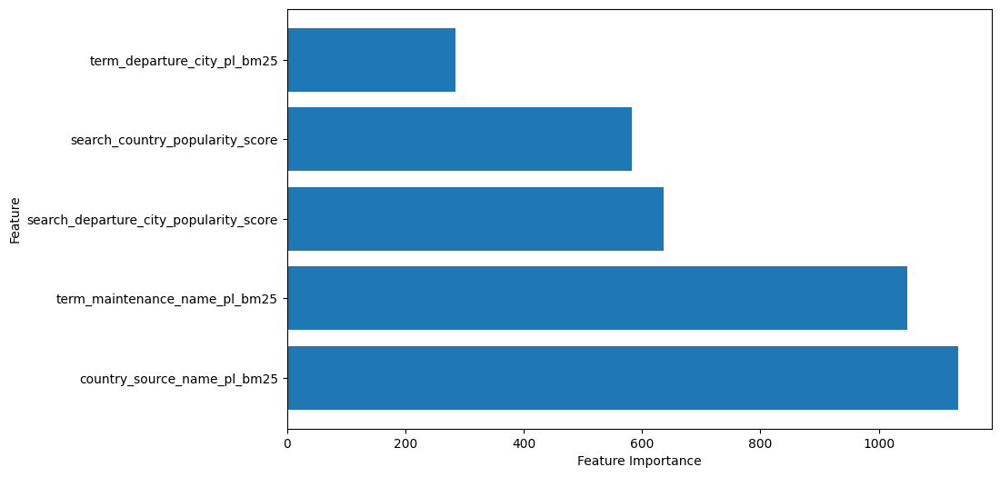

In [74]:
# Przeanalizuj wyniki istotności cech.
importance = model.get_booster().get_score(importance_type='weight')

# Plot feature importance
sorted_importance = sorted(importance.items(), key=lambda x: x[1], reverse=True)
sorted_features, sorted_scores = zip(*sorted_importance)

plt.figure(figsize=(10, 6))
plt.barh(range(len(sorted_scores)), sorted_scores, align='center')
plt.yticks(range(len(sorted_scores)), sorted_features)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.show()

In [75]:
# Zdefiniuj funkcję konwertującą drzewo decyzyjne do formatu JSON wymaganego przez Solr.
# Więcej o modelach: 
# https://solr.apache.org/docs/7_3_0/solr-ltr/org/apache/solr/ltr/model/MultipleAdditiveTreesModel.html

tree_dump = model.get_booster().get_dump(with_stats=True)

def convert_tree_string_to_json(weight, tree_string):
    tree_lines = tree_string.split("\n")
    tree_structure = {
        "weight": str(1),
        "root": parse_node(tree_lines)
    }
    return tree_structure

def parse_node(lines):
    node_structure = {}

    # Check if the node is a leaf node
    if "leaf=" in lines[0]:
        leaf_info = lines[0].split("=")
        node_structure["value"] = str(leaf_info[1].strip().split(",")[0])
    else:
        # Parse feature and threshold for non-leaf nodes
        node_info = lines[0].split(":")
        node_info_parsed = node_info[1].strip().split(" ")[0]
        feature_ = node_info_parsed.split("<")[0].split("[")

        if len(feature_) == 2:
            node_structure["feature"] = feature_[1]
            node_structure["threshold"] = str(
                node_info_parsed.split("<")[1].split("]")[0]
            )

        # Recursively parse left and right child nodes
        node_structure["left"] = parse_node(lines[1:])
        node_structure["right"] = parse_node(lines[2:])

    return node_structure

def convert_trees_to_solr(
        parsed_trees, features, modelName, feature_store_name):
    feature_mapping = [{"name": feat} for feat in features]
    model = {
        "store": feature_store_name,
        "name": model_name,
        "class": "org.apache.solr.ltr.model.MultipleAdditiveTreesModel",
        "features": feature_mapping,
        "params": {"trees": parsed_trees},
    }
    return model


parsed_trees = [
    convert_tree_string_to_json(i, tree_str)
    for i, tree_str in enumerate(tree_dump)
]

model_name = 'model_karolina'

model_parsed_trees = convert_trees_to_solr(
    parsed_trees, features, model_name, feature_store_name
)


In [76]:
model_parsed_trees

{'store': 'features_store',
 'name': 'model_karolina',
 'class': 'org.apache.solr.ltr.model.MultipleAdditiveTreesModel',
 'features': [{'name': 'term_maintenance_name_pl_bm25'},
  {'name': 'term_departure_city_pl_bm25'},
  {'name': 'country_source_name_pl_bm25'},
  {'name': 'search_country_popularity_score'},
  {'name': 'search_departure_city_popularity_score'}],
 'params': {'trees': [{'weight': '1',
    'root': {'feature': 'search_departure_city_popularity_score',
     'threshold': '0.500000477',
     'left': {'feature': 'term_maintenance_name_pl_bm25',
      'threshold': '2.13115883',
      'left': {'feature': 'search_country_popularity_score',
       'threshold': '1.01113796',
       'left': {'feature': 'term_maintenance_name_pl_bm25',
        'threshold': '1.6301986',
        'left': {'feature': 'term_maintenance_name_pl_bm25',
         'threshold': '1.07077861',
         'left': {'feature': 'country_source_name_pl_bm25',
          'threshold': '7.43525696',
          'left': {'val

**Wdrozenie modelu w Solr**

In [77]:
url_model = f'{solr_url}/{collection_name}/schema/model-store'

def upload_model(model_file,model_name):
    base_url = "/schema/model-store"

    response = requests.delete(f"{url_model}/{model_name}")
    if response.status_code != 200:
        print(
            "Status: {0} {1}\nResponse: {2}".format(
                response.status_code, response.reason, ""
            )
        )

    response = requests.put(f"{url_model}", json=model_file)

    if response.status_code == 200:
        print("Model imported to Solr collection.")
    else:
        print(f"Failed to import model. Status code: {response.status_code}. Message: {response.text}")

upload_model(model_parsed_trees, model_name)

Model imported to Solr collection.


**Inferencja:** Użyj wytrenowanego modelu do predykcji rankingów dla nowych danych.

In [89]:
select_url = f'{solr_url}/{collection_name}/select'

def show_query_results(query):
    request = {
        "fields": ["id","score","country_source_name_pl","term_maintenance_name_pl",
                   "term_departure_city_pl","term_base_price","[features]"],
        "limit": 1000,
        "params": {
            "rq": "{!ltr reRankDocs=5000\
            model="+model_name+"\
            efi.keywords=\"" + query + "\"}",
            "qf": "country_source_name_pl",
            "defType": "edismax",
            "q": query
        }
    }

    search_response = requests.post(select_url, json=request).json()
    results = search_response["response"]["docs"]

    df = pd.DataFrame(results)
    df["rank"] = df['score'].rank(method='dense').apply(int)
    df['[features]'] = df['[features]'].str.split(',')
    df['[features]'] = df['[features]'].apply(lambda x: dict(item.split('=') for item in x))
    df = pd.concat([df, df['[features]'].apply(pd.Series)], axis=1)
    df = df.drop('[features]', axis=1)
    df['country_source_name_pl'] = df['country_source_name_pl'].apply(str)
    df = df.drop_duplicates()
    df = df.sort_values(by='rank', ascending=False)
    df = df[['id','rank','score','original_score','country_source_name_pl','term_maintenance_name_pl',
             'term_departure_city_pl','term_maintenance_name_pl_bm25',
             'term_departure_city_pl_bm25','country_source_name_pl_bm25',
             'search_country_popularity_score']]
    return df

In [91]:
query = queries_list[10][0]
print(query)
show_query_results(query)

country=Kuba&departureCity=Warszawa - Okecie&departureDateMax=2023-10-05&departureDateMin=2023-09-25&transportType=samolot&maintenance=All Inclusive&region=Varadero&city=Varadero


,id,rank,score,original_score,country_source_name_pl,term_maintenance_name_pl,term_departure_city_pl,term_maintenance_name_pl_bm25,term_departure_city_pl_bm25,country_source_name_pl_bm25,search_country_popularity_score
0,5836,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
1,6372,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
2,5838,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
3,5835,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
4,6692,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
5,6367,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
6,6697,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
7,6636,2,-4.620571,3.157752,['Kuba'],All Inclusive,Warszawa - Okęcie,2.1207604,2.4704452,3.157752,1.0166667
8,6696,1,-4.813899,3.157752,['Kuba'],All Inclusive,NaN,2.1207604,0.0,3.157752,1.0166667
9,5840,1,-4.813899,3.157752,['Kuba'],All Inclusive,NaN,2.1207604,0.0,3.157752,1.0166667
